# Week 8 C
## Name: Jay Zhang
To solve the question: "What are the genetic factors related to Melanoma when considering the influence of height?"

### 1. Data Preprocessing

In [1]:
!pip3 install sparse_lmm
!pip3 install statsmodels
!pip3 install pandas
!pip3 install numpy
!pip3 install seaborn


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip


In [2]:
# Read file
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sparse_lmm import VariableSelection
clinical_data = pd.read_csv('/Users/kitkatj/Downloads/ai4science/TCGA dataset/TCGA_Melanoma_(SKCM)/TCGA.SKCM.sampleMap_SKCM_clinicalMatrix', sep='\t', index_col=0)
gene_data = pd.read_csv('/Users/kitkatj/Downloads/ai4science/TCGA dataset/TCGA_Melanoma_(SKCM)/TCGA.SKCM.sampleMap_HiSeqV2_PANCAN', sep='\t', index_col=0)
pd.options.display.max_columns = None

In [3]:
# Display clinical dataset
clinical_data.head()

,_INTEGRATION,_PATIENT,_cohort,_primary_disease,_primary_site,additional_pharmaceutical_therapy,additional_radiation_therapy,age_at_initial_pathologic_diagnosis,bcr_followup_barcode,bcr_patient_barcode,bcr_sample_barcode,breslow_depth_value,days_to_birth,days_to_collection,days_to_death,days_to_initial_pathologic_diagnosis,days_to_last_followup,days_to_new_tumor_event_additional_surgery_procedure,days_to_new_tumor_event_after_initial_treatment,days_to_submitted_specimen_dx,distant_metastasis_anatomic_site,followup_case_report_form_submission_reason,form_completion_date,gender,height,history_of_neoadjuvant_treatment,icd_10,icd_o_3_histology,icd_o_3_site,informed_consent_verified,initial_weight,interferon_90_day_prior_excision_admin_indicator,is_ffpe,lactate_dehydrogenase_result,lost_follow_up,malignant_neoplasm_mitotic_count_rate,melanoma_clark_level_value,melanoma_origin_skin_anatomic_site,melanoma_ulceration_indicator,new_neoplasm_event_occurrence_anatomic_site,new_neoplasm_event_type,new_non_melanoma_event_histologic_type_text,new_primary_melanoma_anatomic_site,new_tumor_dx_prior_submitted_specimen_dx,new_tumor_event_additional_surgery_procedure,new_tumor_event_after_initial_treatment,new_tumor_metastasis_anatomic_site,new_tumor_metastasis_anatomic_site_other_text,oct_embedded,other_dx,pathologic_M,pathologic_N,pathologic_T,pathologic_stage,pathology_report_file_name,patient_id,person_neoplasm_cancer_status,postoperative_rx_tx,primary_anatomic_site_count,primary_melanoma_at_diagnosis_count,primary_neoplasm_melanoma_dx,primary_tumor_multiple_present_ind,prior_systemic_therapy_type,radiation_therapy,sample_type,sample_type_id,subsequent_primary_melanoma_during_followup,system_version,tissue_prospective_collection_indicator,tissue_retrospective_collection_indicator,tissue_source_site,tissue_type,tumor_descriptor,tumor_tissue_site,vial_number,vital_status,weight,year_of_initial_pathologic_diagnosis,_GENOMIC_ID_TCGA_SKCM_exp_HiSeqV2,_GENOMIC_ID_TCGA_SKCM_hMethyl450,_GENOMIC_ID_TCGA_SKCM_exp_HiSeqV2_PANCAN,_GENOMIC_ID_TCGA_SKCM_miRNA_HiSeq,_GENOMIC_ID_TCGA_SKCM_gistic2thd,_GENOMIC_ID_data/public/TCGA/SKCM/miRNA_HiSeq_gene,_GENOMIC_ID_TCGA_SKCM_RPPA,_GENOMIC_ID_TCGA_SKCM_mutation_bcm_gene,_GENOMIC_ID_TCGA_SKCM_mutation_broad_gene,_GENOMIC_ID_TCGA_SKCM_gistic2,_GENOMIC_ID_TCGA_SKCM_mutation,_GENOMIC_ID_TCGA_SKCM_exp_HiSeqV2_exon,_GENOMIC_ID_TCGA_SKCM_PDMRNAseqCNV,_GENOMIC_ID_TCGA_SKCM_PDMRNAseq,_GENOMIC_ID_TCGA_SKCM_exp_HiSeqV2_percentile
sampleID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
TCGA-3N-A9WB-06,TCGA-3N-A9WB-06,TCGA-3N-A9WB,TCGA Melanoma (SKCM),skin cutaneous melanoma,Skin,NaN,NaN,71.0,NaN,TCGA-3N-A9WB,TCGA-3N-A9WB-06A,0.70,-26176.0,552.0,518.0,0.0,NaN,NaN,NaN,426.0,Left Flank,NaN,2014-5-29,MALE,175.0,No,C44.5,8720/3,C44.5,YES,90.0,NaN,NO,NaN,NaN,2.0,III,Non-glabrous skin,NO,NaN,NaN,NaN,NaN,NO,NaN,YES,NaN,NaN,False,No,M0,NX,T1a,Stage IA,TCGA-3N-A9WB.773FA4D0-E15C-4138-A961-4F610C1DE...,A9WB,WITH TUMOR,NO,1,NaN,YES,NO,NaN,NO,Metastatic,6.0,NaN,7th,YES,NO,3N,NaN,NaN,Distant Metastasis,A,DECEASED,78.0,2012.0,4c243ea9-dfe1-42f0-a887-3c901fb38542,TCGA-3N-A9WB-06A-11D-A38H-05,4c243ea9-dfe1-42f0-a887-3c901fb38542,NaN,TCGA-3N-A9WB-06A-11D-A38F-01,NaN,NaN,NaN,TCGA-3N-A9WB-06A-11D-A38G-08,TCGA-3N-A9WB-06A-11D-A38F-01,NaN,4c243ea9-dfe1-42f0-a887-3c901fb38542,NaN,NaN,4c243ea9-dfe1-42f0-a887-3c901fb38542
TCGA-3N-A9WC-06,TCGA-3N-A9WC-06,TCGA-3N-A9WC,TCGA Melanoma (SKCM),skin cutaneous melanoma,Skin,NaN,NaN,82.0,TCGA-3N-A9WC-F67104,TCGA-3N-A9WC,TCGA-3N-A9WC-06A,1.80,-30286.0,1709.0,NaN,0.0,2022,NaN,NaN,1644.0,NaN,NaN,2014-11-4,MALE,183.0,No,C77.3,8720/3,C77.3,YES,220.0,NaN,NO,NaN,NO,4.0,IV,Non-glabrous skin,YES,NaN,NaN,NaN,NaN,NO,NaN,NO,NaN,NaN,False,No,M0,NX,T2b,Stage IIA,TCGA-3N-A9WC.DF472314-0643-473F-9233-EC7750514...,A9WC,WITH TUMOR,NO,1,1.0,YES,NO,NaN,NO,Metastatic,6.0,NO,6th,YES,NO,3N,NaN,NaN,Regional Lymph Node,A,LIVING,68.0,2009.0,a64ae1f5-a189-4173-be13-903bd7637869,TCGA-3N-A9WC

In [4]:
# Display gene dataset
gene_data.head()

,TCGA-YD-A89C-06,TCGA-Z2-AA3V-06,TCGA-EB-A3Y6-01,TCGA-EE-A3JA-06,TCGA-D9-A4Z2-01,TCGA-D3-A51G-06,TCGA-3N-A9WD-06,TCGA-GF-A2C7-01,TCGA-WE-A8ZY-06,TCGA-D3-A8GI-06,TCGA-FR-A7U8-06,TCGA-D3-A51K-06,TCGA-BF-A3DJ-01,TCGA-BF-A3DL-01,TCGA-EB-A44N-01,TCGA-EB-A6L9-06,TCGA-GN-A26C-01,TCGA-EE-A29N-06,TCGA-EE-A3J4-06,TCGA-D3-A51F-06,TCGA-EE-A29X-06,TCGA-EE-A2GM-06,TCGA-BF-AAP7-01,TCGA-ER-A2NH-06,TCGA-EE-A3JH-06,TCGA-DA-A1I7-06,TCGA-EE-A2GT-06,TCGA-BF-AAP4-01,TCGA-EE-A3AB-06,TCGA-FS-A1ZB-06,TCGA-EE-A2GK-06,TCGA-D3-A1Q5-06,TCGA-EE-A29W-06,TCGA-D3-A3C7-06,TCGA-EE-A29M-06,TCGA-BF-A5ES-01,TCGA-EE-A20C-06,TCGA-FR-A729-06,TCGA-D9-A6EA-06,TCGA-EE-A20I-06,TCGA-IH-A3EA-01,TCGA-XV-AAZW-01,TCGA-D3-A8GB-06,TCGA-BF-A1PV-01,TCGA-GF-A3OT-06,TCGA-EE-A2M6-06,TCGA-EE-A2GH-06,TCGA-FW-A5DY-06,TCGA-DA-A1I5-06,TCGA-D3-A8GQ-06,TCGA-EE-A29G-06,TCGA-ER-A19P-06,TCGA-EE-A3JE-06,TCGA-EE-A2M7-06,TCGA-EE-A3AG-06,TCGA-D3-A2JP-06,TCGA-EE-A3J7-06,TCGA-D3-A8GO-06,TCGA-D3-A2JF-06,TCGA-FS-A1ZT-06,TCGA-ER-A199-06,TCGA-GF-A4EO-06,TCGA-D3-A5GT-01,TCGA-D3-A1QA-07,TCGA-D3-A8GE-06,TCGA-EE-A17Y-06,TCGA-EE-A2GP-06,TCGA-EB-A42Y-01,TCGA-EB-A44Q-06,TCGA-FR-A3R1-01,TCGA-RP-A694-06,TCGA-DA-A1I0-06,TCGA-D3-A1Q9-06,TCGA-D3-A5GS-06,TCGA-DA-A1I8-06,TCGA-D3-A8GK-06,TCGA-FS-A1ZR-06,TCGA-DA-A1IB-06,TCGA-EE-A185-06,TCGA-EE-A20F-06,TCGA-EE-A29A-06,TCGA-D3-A3CC-06,TCGA-D3-A2JD-06,TCGA-FS-A1ZS-06,TCGA-HR-A2OH-06,TCGA-EE-A2MD-06,TCGA-EE-A3AH-06,TCGA-HR-A5NC-01,TCGA-FR-A7U9-06,TCGA-D9-A4Z3-01,TCGA-FR-A69P-06,TCGA-EB-A4IS-01,TCGA-FS-A1ZZ-06,TCGA-GN-A265-06,TCGA-GN-A8LK-06,TCGA-D3-A2JK-06,TCGA-D3-A2J6-06,TCGA-FS-A4F2-06,TCGA-EE-A2MI-06,TCGA-D3-A3BZ-06,TCGA-GN-A8LL-06,TCGA-D3-A3CF-06,TCGA-EB-A4OY-01,TCGA-GF-A769-01,TCGA-D3-A1Q1-06,TCGA-FR-A8YC-06,TCGA-FW-A5DX-01,TCGA-ER-A2NF-06,TCGA-D3-A5GN-06,TCGA-DA-A3F5-06,TCGA-EB-A3XE-01,TCGA-FS-A1ZM-06,TCGA-EE-A29L-06,TCGA-D3-A5GU-06,TCGA-D3-A3C6-06,TCGA-BF-A5EP-01,TCGA-EE-A2MF-06,TCGA-EE-A20H-06,TCGA-FS-A1ZC-06,TCGA-D3-A2JG-06,TCGA-GN-A261-06,TCGA-D3-A8GD-06,TCGA-EE-A29T-06,TCGA-EB-A430-01,TCGA-YD-A9TB-06,TCGA-EB-A44O-01,TCGA-D9-A6EG-06,TCGA-Z2-A8RT-06,TCGA-DA-A1IA-06,TCGA-D3-A1Q8-06,TCGA-D9-A3Z3-06,TCGA-DA-A3F2-06,TCGA-ER-A19G-06,TCGA-DA-A960-01,TCGA-FS-A1Z4-06,TCGA-RP-A690-06,TCGA-ER-A19T-01,TCGA-FS-A1ZH-06,TCGA-EE-A29E-06,TCGA-EE-A3JI-06,TCGA-D9-A148-06,TCGA-BF-A3DM-01,TCGA-ER-A19O-06,TCGA-GN-A264-06,TCGA-QB-AA9O-06,TCGA-DA-A3F3-06,TCGA-D3-A2JO-06,TCGA-ER-A195-06,TCGA-EB-A85J-01,TCGA-EE-A183-06,TCGA-DA-A3F8-06,TCGA-D9-A149-06,TCGA-DA-A1I2-06,TCGA-D3-A2JC-06,TCGA-EE-A2MC-06,TCGA-FS-A1ZF-06,TCGA-EB-A5VU-01,TCGA-FS-A1ZG-06,TCGA-D3-A8GP-06,TCGA-D3-A1Q3-06,TCGA-EE-A2A6-06,TCGA-EE-A2MN-06,TCGA-ER-A196-01,TCGA-D9-A1JX-06,TCGA-ER-A19D-06,TCGA-GN-A262-06,TCGA-ER-A19E-06,TCGA-EE-A2MM-06,TCGA-EE-A29V-06,TCGA-EB-A5UN-06,TCGA-ER-A19N-06,TCGA-EE-A2GR-06,TCGA-3N-A9WC-06,TCGA-BF-A1PU-01,TCGA-D9-A6E9-06,TCGA-BF-A5ER-01,TCGA-D3-A51H-06,TCGA-D3-A8GM-06,TCGA-EB-A1NK-01,TCGA-XV-AAZV-01,TCGA-EE-A3AE-06,TCGA-FR-A728-01,TCGA-EB-A5SG-06,TCGA-EE-A2GL-06,TCGA-DA-A95W-06,TCGA-EE-A2MH-06,TCGA-BF-AAP6-01,TCGA-WE-A8K4-01,TCGA-W3-A824-06,TCGA-DA-A1HW-06,TCGA-W3-AA1W-06,TCGA-EB-A5UL-06,TCGA-EB-A3HV-01,TCGA-D3-A1Q6-06,TCGA-GN-A4U4-06,TCGA-EE-A2A5-06,TCGA-ER-A19A-06,TCGA-FS-A1ZK-06,TCGA-BF-AAP0-06,TCGA-FR-A3YO-06,TCGA-DA-A1HV-06,TCGA-WE-A8K5-06,TCGA-FS-A4FD-06,TCGA-EE-A2MS-06,TCGA-D3-A8GR-06,TCGA-ER-A194-01,TCGA-D3-A3CB-06,TCGA-D3-A1QA-06,TCGA-EE-A3J8-06,TCGA-EE-A2ML-06,TCGA-EE-A2MU-06,TCGA-ER-A19T-06,TCGA-XV-AAZY-01,TCGA-FS-A1ZY-06,TCGA-EB-A24C-01,TCGA-D3-A3MO-06,TCGA-FS-A4FB-06,TCGA-EE-A2ME-06,TCGA-EE-A184-06,TCGA-EE-A20B-06,TCGA-D3-A3C1-06,TCGA-ER-A19F-06,TCGA-EE-A3AC-06,TCGA-EE-A29Q-06,TCGA-EE-A29H-06,TCGA-D3-A8GC-06,TCGA-EE-A2A2-06,TCGA-ER-A3PL-06,TCGA-ER-A2NB-01,TCGA-EB-A41A-01,TCGA-D3-A3C8-06,TCGA-FS-A4FC-06,TCGA-EE-A3AD-06,TCGA-EE-A2GB-06,TCGA-XV-A9W2-01,TCGA-D3-A2JH-06,TCGA-EE-A29R-06,TCGA-WE-AAA0-06,TCGA-DA-A95X-06,TCGA-DA-A95Y-06,TCGA-GN-A268-06,TCGA-EE-A181-06,TCGA-BF-A9VF-01,TCGA-EE-A29B-06,TCGA-EE-A2GJ-06,TCGA-D3-A3ML-06,TCGA-GN-A4U9-06,TCGA-FW-A3I3-06,TCGA-BF-AAP2-01,TCGA-EB-A4P0-01

In [5]:
# Set Basic info
trait = 'Melanoma'
condition = 'height'
condition_col = 'height'
gene_list = gene_data.index.tolist()
# Get the feature dimension of clinical data, and the number of genes
col_offset = len(clinical_data.columns)
num_genes = len(gene_list)
print(f'The clinical dataset has {col_offset} features, and the gene dataset includes {num_genes} genes')

The clinical dataset has 93 features, and the gene dataset includes 20530 genes


In [6]:
# Merge clinical_data and gene_data on their indices - sample_ID, corresponding to each person
merged_data = clinical_data.join(gene_data.T)
merged_data.head()

,_INTEGRATION,_PATIENT,_cohort,_primary_disease,_primary_site,additional_pharmaceutical_therapy,additional_radiation_therapy,age_at_initial_pathologic_diagnosis,bcr_followup_barcode,bcr_patient_barcode,bcr_sample_barcode,breslow_depth_value,days_to_birth,days_to_collection,days_to_death,days_to_initial_pathologic_diagnosis,days_to_last_followup,days_to_new_tumor_event_additional_surgery_procedure,days_to_new_tumor_event_after_initial_treatment,days_to_submitted_specimen_dx,distant_metastasis_anatomic_site,followup_case_report_form_submission_reason,form_completion_date,gender,height,history_of_neoadjuvant_treatment,icd_10,icd_o_3_histology,icd_o_3_site,informed_consent_verified,initial_weight,interferon_90_day_prior_excision_admin_indicator,is_ffpe,lactate_dehydrogenase_result,lost_follow_up,malignant_neoplasm_mitotic_count_rate,melanoma_clark_level_value,melanoma_origin_skin_anatomic_site,melanoma_ulceration_indicator,new_neoplasm_event_occurrence_anatomic_site,new_neoplasm_event_type,new_non_melanoma_event_histologic_type_text,new_primary_melanoma_anatomic_site,new_tumor_dx_prior_submitted_specimen_dx,new_tumor_event_additional_surgery_procedure,new_tumor_event_after_initial_treatment,new_tumor_metastasis_anatomic_site,new_tumor_metastasis_anatomic_site_other_text,oct_embedded,other_dx,pathologic_M,pathologic_N,pathologic_T,pathologic_stage,pathology_report_file_name,patient_id,person_neoplasm_cancer_status,postoperative_rx_tx,primary_anatomic_site_count,primary_melanoma_at_diagnosis_count,primary_neoplasm_melanoma_dx,primary_tumor_multiple_present_ind,prior_systemic_therapy_type,radiation_therapy,sample_type,sample_type_id,subsequent_primary_melanoma_during_followup,system_version,tissue_prospective_collection_indicator,tissue_retrospective_collection_indicator,tissue_source_site,tissue_type,tumor_descriptor,tumor_tissue_site,vial_number,vital_status,weight,year_of_initial_pathologic_diagnosis,_GENOMIC_ID_TCGA_SKCM_exp_HiSeqV2,_GENOMIC_ID_TCGA_SKCM_hMethyl450,_GENOMIC_ID_TCGA_SKCM_exp_HiSeqV2_PANCAN,_GENOMIC_ID_TCGA_SKCM_miRNA_HiSeq,_GENOMIC_ID_TCGA_SKCM_gistic2thd,_GENOMIC_ID_data/public/TCGA/SKCM/miRNA_HiSeq_gene,_GENOMIC_ID_TCGA_SKCM_RPPA,_GENOMIC_ID_TCGA_SKCM_mutation_bcm_gene,_GENOMIC_ID_TCGA_SKCM_mutation_broad_gene,_GENOMIC_ID_TCGA_SKCM_gistic2,_GENOMIC_ID_TCGA_SKCM_mutation,_GENOMIC_ID_TCGA_SKCM_exp_HiSeqV2_exon,_GENOMIC_ID_TCGA_SKCM_PDMRNAseqCNV,_GENOMIC_ID_TCGA_SKCM_PDMRNAseq,_GENOMIC_ID_TCGA_SKCM_exp_HiSeqV2_percentile,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC100132288,DENND4A,DENND4B,DENND4C,SWAP70,RARRES1,LOC100132287,PHLDA3,PHLDA2,TACO1,PMM1,GAP43,NENF,SQLE,MRPL28,LOC100289341,FBXL13,FBXL12,FBXL15,CYP27B1,FBXL17,FBXL16,FAM169A,FAM116B,FAM116A,FAM169B,RALGAPA2,GHDC,H19,SDK2,GRP,TPRN,THSD4,KIAA0895L,CHST9,CHST8,COL4A5,COL4A4,COL4A3,COL4A2,COL4A1,SLC35D2,CHST1,ZNF879,CHST3,CHST2,CHST5,CHST4,CHST7,CHST6,ITGAX,OR8J1,SNORD115-17,BCL2A1,GPSM2,HLCS,NOG,LIPG,ITGAV,HIBCH,ZNF703,ITGAL,ITGAM,LOC286359,HLF,NOV,FAM134C,FAM134B,FAM134A,SERPING1,SMAD9,TRERF1,LOC653501,LRPAP1,LQK1,SMAD6,SMAD7,GOLPH3L,SMAD1,AFTPH,SMAD3,MUS81,AMMECR1L,IL1RAPL1,TMPRSS11B,IGF2R,TMPRSS11D,TMPRSS11F,ZC3H10,RAD21L1,IL1RAPL2,SLC36A3,CKS1B,SLC36A1,ST13,RPL31P11,C14orf115,ZC3H15,TMEM213,C14orf118,ARTN,ART1,HRH3,ART3,HERC2P2,ART5,ART4,RNF111,TCEA2,TCEA3,TCEA1,MGC57346,COX4I2,COX4I1,BFAR,ZC3H18,TMEM212,SNORD115-13,TCEB3B,SIPA1,CRTAM,EDA,OR6P1,CCDC116,CADPS2,CCDC114,CCDC115,CCDC112,CCDC113,CCDC110,C

In [7]:
# Only select relevant columns
feature_cols = [condition_col] + gene_list
merged_data = merged_data[feature_cols]

# Remove sample rows with missing columns.
threshold_rows = 0.8 * len(merged_data)
rows_after_any = len(merged_data.dropna(how='any'))

# Prefer "how='any'", if it does not discard too much data.
if rows_after_any >= threshold_rows:
    merged_data = merged_data.dropna(how='any')
else:
    merged_data = merged_data.dropna(how='all')
    merged_data = merged_data.fillna(0)

# delete all 0 value entrance
merged_data = merged_data.loc[merged_data[condition_col] != 0]
merged_data.head()

,height,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC100132288,DENND4A,DENND4B,DENND4C,SWAP70,RARRES1,LOC100132287,PHLDA3,PHLDA2,TACO1,PMM1,GAP43,NENF,SQLE,MRPL28,LOC100289341,FBXL13,FBXL12,FBXL15,CYP27B1,FBXL17,FBXL16,FAM169A,FAM116B,FAM116A,FAM169B,RALGAPA2,GHDC,H19,SDK2,GRP,TPRN,THSD4,KIAA0895L,CHST9,CHST8,COL4A5,COL4A4,COL4A3,COL4A2,COL4A1,SLC35D2,CHST1,ZNF879,CHST3,CHST2,CHST5,CHST4,CHST7,CHST6,ITGAX,OR8J1,SNORD115-17,BCL2A1,GPSM2,HLCS,NOG,LIPG,ITGAV,HIBCH,ZNF703,ITGAL,ITGAM,LOC286359,HLF,NOV,FAM134C,FAM134B,FAM134A,SERPING1,SMAD9,TRERF1,LOC653501,LRPAP1,LQK1,SMAD6,SMAD7,GOLPH3L,SMAD1,AFTPH,SMAD3,MUS81,AMMECR1L,IL1RAPL1,TMPRSS11B,IGF2R,TMPRSS11D,TMPRSS11F,ZC3H10,RAD21L1,IL1RAPL2,SLC36A3,CKS1B,SLC36A1,ST13,RPL31P11,C14orf115,ZC3H15,TMEM213,C14orf118,ARTN,ART1,HRH3,ART3,HERC2P2,ART5,ART4,RNF111,TCEA2,TCEA3,TCEA1,MGC57346,COX4I2,COX4I1,BFAR,ZC3H18,TMEM212,SNORD115-13,TCEB3B,SIPA1,CRTAM,EDA,OR6P1,CCDC116,CADPS2,CCDC114,CCDC115,CCDC112,CCDC113,CCDC110,CCDC111,LEO1,ATP1A4,ATP1A3,ATP1A2,ATP1A1,KGFLP2,MGRN1,TCP1,CRTAP,CBLC,SPHK1,DPT,BPESC1,CUEDC1,CUEDC2,CBLB,CPEB4,CPEB1,ZNF45,CPEB3,CPEB2,BEGAIN,RBMXL3,OSGEP,ABAT,LOC100129637,ZNF780A,ZNF780B,TLN2,FRG1,FRG2,RHEBL1,ZNF41,IFT80,FBRS,ZNF414,IFT88,IL10RA,POU5F1B,SP1,SLC27A4,SP2,OLA1,PNOC,CNTF,MCM10,PDIA5,SP4,TMEM38B,THUMPD3,IGFBPL1,SP5,ATG4C,ATG4B,ATG4A,THUMPD2,LOC441208,ATG4D,PHOX2A,PHOX2B,SNORD114-31,SNORD114-30,LRGUK,MPHOSPH8,UPK2,CFH,CFI,PNP,ANKFY1,C1orf14,CFB,OR5P3,OR5P2,MLLT4,SNORD115-6,CREBBP,PNN,PHYHIPL,ATP6V0E1,ATP6V0E2,RNF128,CFP,AAAS,HAMP,ZNF394,SIDT1,SERPINA10,SIDT2,SNORD115-7,TAF8,PISRT1,SIX4,LOC283070,SIX6,PM20D1,MR1,MGC4473,SIX3,SNORD115-4,WASH3P,CNPY4,CNPY3,CNPY2,CNPY1,NODAL,SYNJ1,KNDC1,HMG20A,HMG20B,PHOSPHO2,AAGAB,C4orf19,C3orf79,SLC7A6OS,C3orf77,C3orf75,C3orf74,C4orf10,C3orf72,C3orf71,C3orf70,ZNF285,MRO,ZFP82,CHFR,EFHA1,RTBDN,EFHA2,AAA1,GPR75,NUDT9P1,SYPL2,RFX8,ZNF222,RFX4,OR2C3,AVPR2,RFX7,NRXN3,GPR77,NRXN1,RFX3,SNORD104,RFPL2,VPS37D,NLRP13,APC,TMEM179B,ABCE1,UQCRC2,XPNPEP1,XPNPEP2,TIGD4,ZNHIT3,GGCX,PAPLN,ADNP,TMEM218,STXBP6,KHDRBS1,RUNDC2C,KHDRBS3,GGCT,VPS37C,STAC2,LOC283404,ZNF395,STAC3,TBL1Y,LHCGR,TMEM211,OR1Q1,TMEM127,GPR78,TRPA1,VPS37B,TTC7A,UQCRHL,ZBED4,C11orf2,C11orf1,DPYSL5,DPYSL2,DPYSL3,OSTM1,RUNX2,C11orf9,KRTAP10-12,KRTAP10-11,KRTAP10-10,IGFBP2,IGFBP3,IGFBP1,BOP1,IGFBP7,IGFBP4,IGFBP5,SKP2,TTC4,CYP2R1,CKLF,ZNF193,C15orf26,C15orf27,C15orf24,GJA3,APLNR,C15orf23,C15orf21,GJA8,CYP8B1,C15orf28,C15orf29,STMN1,S1PR2,KDM3B,REG1P,STK17A,KDM3A,LOC401387,S1PR1,ZNF642,TMC4,MYO3A,TMC6,KIAA1958,APIP,TMC1,GPR15,TMC3,PKLR,TECRL,EIF2B4,EIF2B5,EIF2B2,EIF2B3,EIF2B1,PRKAR2A,CSNK2A1P,XRRA1,C20orf56,C20orf54,TXNIP,SLC36A4,LOC389791,ZNF876P,MLF1,QPRT,IFT140,MLF2,TMEM14C,FAM157A,FAM157B,FANCF,MECOM,ITGA2B,RSPH1,IFI16,SOX6,LOC440944,TTC1,C9orf128,C9orf129,MYT1L,C9orf125,C9orf122,CEPT1,KIAA1267,RTCD1,CFHR2,CFHR3,CLIC4,CLIC5,CLIC2,CLIC3,CFHR4,CFHR5,KRTAP2-2,KRTAP2-1,CXorf1,KIAA0020,KRTAP2-4,TMEM147,ASGR1,ASGR2,PCDHA1,FOXL2,RIT1,TMEM141,FOXL1,SF1,PCDHA6,PKIB,TMEM149,API5,KRTCAP3,NUMBL,RTKN2,RNF180,P2RX7,SECISBP2L,SBF1P1,LOC100128811,HAS2,KIAA1199,HLA-DPA1,ZSWIM3,FAM32A,KIAA1191,FER1L6,ALOX12P2,FER1L4,FER1L5,CA5B,ZNF559,VWA1,C19orf22,C19orf23,C19orf20,C19orf21,C19orf26,ZMAT4,C19orf24,C19orf25,MYBL1,NR1D1,C19orf28,C19orf29,ITGB1BP1,ITGB1BP3,ITGB1BP2,ZNF7,ZNF2,ZNF3,CTCFL,PHLDA1,RPL31,ZNF8,PCP4L1,C11orf17,C11orf16,ZAP70,SNORD115-9,C11orf10,ZCCHC13,UFSP2,OGFR,EPM2AIP1,CDC5L,RAC2,RAC3,RAC1,SBDS,RCL1,SBK2,MRPS18A,CPLX2,CPLX3,ORC3L,CPLX1,AP2

In [8]:
# Decode the trait information from Sample IDs. Tumor types range from 01 - 09, normal types from 10 - 19.
# Create a function to check the last two digits of a row index

def mark_tumor(row_index):
    last_two_digits = int(row_index[-2:])
    
    mapping = {
        (1, 9): 1,
        (10, 19): 0
    }
    
    return next((value for (start, end), value in mapping.items() if start <= last_two_digits <= end), -1)


# Use the apply function to add the trait column to merged_data
merged_data[trait] = merged_data.index.to_series().apply(mark_tumor)

merged_data.head()

,height,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC100132288,DENND4A,DENND4B,DENND4C,SWAP70,RARRES1,LOC100132287,PHLDA3,PHLDA2,TACO1,PMM1,GAP43,NENF,SQLE,MRPL28,LOC100289341,FBXL13,FBXL12,FBXL15,CYP27B1,FBXL17,FBXL16,FAM169A,FAM116B,FAM116A,FAM169B,RALGAPA2,GHDC,H19,SDK2,GRP,TPRN,THSD4,KIAA0895L,CHST9,CHST8,COL4A5,COL4A4,COL4A3,COL4A2,COL4A1,SLC35D2,CHST1,ZNF879,CHST3,CHST2,CHST5,CHST4,CHST7,CHST6,ITGAX,OR8J1,SNORD115-17,BCL2A1,GPSM2,HLCS,NOG,LIPG,ITGAV,HIBCH,ZNF703,ITGAL,ITGAM,LOC286359,HLF,NOV,FAM134C,FAM134B,FAM134A,SERPING1,SMAD9,TRERF1,LOC653501,LRPAP1,LQK1,SMAD6,SMAD7,GOLPH3L,SMAD1,AFTPH,SMAD3,MUS81,AMMECR1L,IL1RAPL1,TMPRSS11B,IGF2R,TMPRSS11D,TMPRSS11F,ZC3H10,RAD21L1,IL1RAPL2,SLC36A3,CKS1B,SLC36A1,ST13,RPL31P11,C14orf115,ZC3H15,TMEM213,C14orf118,ARTN,ART1,HRH3,ART3,HERC2P2,ART5,ART4,RNF111,TCEA2,TCEA3,TCEA1,MGC57346,COX4I2,COX4I1,BFAR,ZC3H18,TMEM212,SNORD115-13,TCEB3B,SIPA1,CRTAM,EDA,OR6P1,CCDC116,CADPS2,CCDC114,CCDC115,CCDC112,CCDC113,CCDC110,CCDC111,LEO1,ATP1A4,ATP1A3,ATP1A2,ATP1A1,KGFLP2,MGRN1,TCP1,CRTAP,CBLC,SPHK1,DPT,BPESC1,CUEDC1,CUEDC2,CBLB,CPEB4,CPEB1,ZNF45,CPEB3,CPEB2,BEGAIN,RBMXL3,OSGEP,ABAT,LOC100129637,ZNF780A,ZNF780B,TLN2,FRG1,FRG2,RHEBL1,ZNF41,IFT80,FBRS,ZNF414,IFT88,IL10RA,POU5F1B,SP1,SLC27A4,SP2,OLA1,PNOC,CNTF,MCM10,PDIA5,SP4,TMEM38B,THUMPD3,IGFBPL1,SP5,ATG4C,ATG4B,ATG4A,THUMPD2,LOC441208,ATG4D,PHOX2A,PHOX2B,SNORD114-31,SNORD114-30,LRGUK,MPHOSPH8,UPK2,CFH,CFI,PNP,ANKFY1,C1orf14,CFB,OR5P3,OR5P2,MLLT4,SNORD115-6,CREBBP,PNN,PHYHIPL,ATP6V0E1,ATP6V0E2,RNF128,CFP,AAAS,HAMP,ZNF394,SIDT1,SERPINA10,SIDT2,SNORD115-7,TAF8,PISRT1,SIX4,LOC283070,SIX6,PM20D1,MR1,MGC4473,SIX3,SNORD115-4,WASH3P,CNPY4,CNPY3,CNPY2,CNPY1,NODAL,SYNJ1,KNDC1,HMG20A,HMG20B,PHOSPHO2,AAGAB,C4orf19,C3orf79,SLC7A6OS,C3orf77,C3orf75,C3orf74,C4orf10,C3orf72,C3orf71,C3orf70,ZNF285,MRO,ZFP82,CHFR,EFHA1,RTBDN,EFHA2,AAA1,GPR75,NUDT9P1,SYPL2,RFX8,ZNF222,RFX4,OR2C3,AVPR2,RFX7,NRXN3,GPR77,NRXN1,RFX3,SNORD104,RFPL2,VPS37D,NLRP13,APC,TMEM179B,ABCE1,UQCRC2,XPNPEP1,XPNPEP2,TIGD4,ZNHIT3,GGCX,PAPLN,ADNP,TMEM218,STXBP6,KHDRBS1,RUNDC2C,KHDRBS3,GGCT,VPS37C,STAC2,LOC283404,ZNF395,STAC3,TBL1Y,LHCGR,TMEM211,OR1Q1,TMEM127,GPR78,TRPA1,VPS37B,TTC7A,UQCRHL,ZBED4,C11orf2,C11orf1,DPYSL5,DPYSL2,DPYSL3,OSTM1,RUNX2,C11orf9,KRTAP10-12,KRTAP10-11,KRTAP10-10,IGFBP2,IGFBP3,IGFBP1,BOP1,IGFBP7,IGFBP4,IGFBP5,SKP2,TTC4,CYP2R1,CKLF,ZNF193,C15orf26,C15orf27,C15orf24,GJA3,APLNR,C15orf23,C15orf21,GJA8,CYP8B1,C15orf28,C15orf29,STMN1,S1PR2,KDM3B,REG1P,STK17A,KDM3A,LOC401387,S1PR1,ZNF642,TMC4,MYO3A,TMC6,KIAA1958,APIP,TMC1,GPR15,TMC3,PKLR,TECRL,EIF2B4,EIF2B5,EIF2B2,EIF2B3,EIF2B1,PRKAR2A,CSNK2A1P,XRRA1,C20orf56,C20orf54,TXNIP,SLC36A4,LOC389791,ZNF876P,MLF1,QPRT,IFT140,MLF2,TMEM14C,FAM157A,FAM157B,FANCF,MECOM,ITGA2B,RSPH1,IFI16,SOX6,LOC440944,TTC1,C9orf128,C9orf129,MYT1L,C9orf125,C9orf122,CEPT1,KIAA1267,RTCD1,CFHR2,CFHR3,CLIC4,CLIC5,CLIC2,CLIC3,CFHR4,CFHR5,KRTAP2-2,KRTAP2-1,CXorf1,KIAA0020,KRTAP2-4,TMEM147,ASGR1,ASGR2,PCDHA1,FOXL2,RIT1,TMEM141,FOXL1,SF1,PCDHA6,PKIB,TMEM149,API5,KRTCAP3,NUMBL,RTKN2,RNF180,P2RX7,SECISBP2L,SBF1P1,LOC100128811,HAS2,KIAA1199,HLA-DPA1,ZSWIM3,FAM32A,KIAA1191,FER1L6,ALOX12P2,FER1L4,FER1L5,CA5B,ZNF559,VWA1,C19orf22,C19orf23,C19orf20,C19orf21,C19orf26,ZMAT4,C19orf24,C19orf25,MYBL1,NR1D1,C19orf28,C19orf29,ITGB1BP1,ITGB1BP3,ITGB1BP2,ZNF7,ZNF2,ZNF3,CTCFL,PHLDA1,RPL31,ZNF8,PCP4L1,C11orf17,C11orf16,ZAP70,SNORD115-9,C11orf10,ZCCHC13,UFSP2,OGFR,EPM2AIP1,CDC5L,RAC2,RAC3,RAC1,SBDS,RCL1,SBK2,MRPS18A,CPLX2,CPLX3,ORC3L,CPLX1,AP2

### 2. Preliminary analysis

Plot the distributions of the target and important regressors

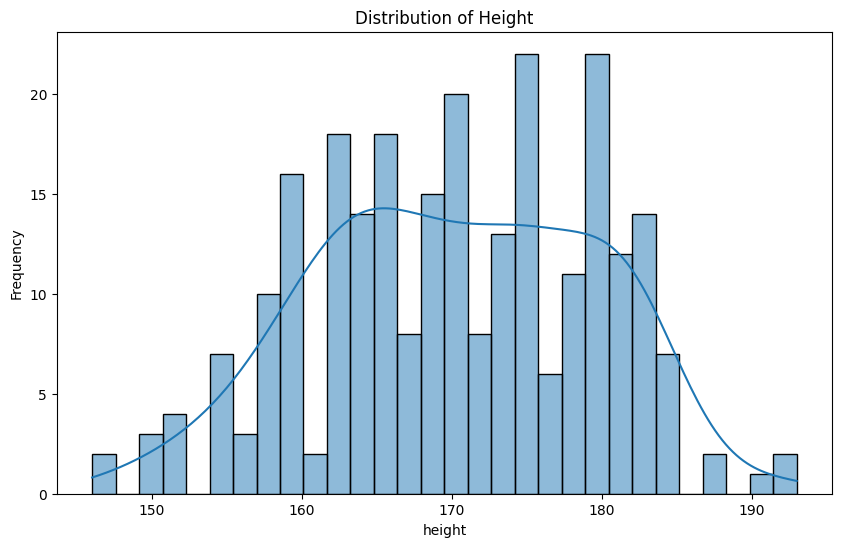

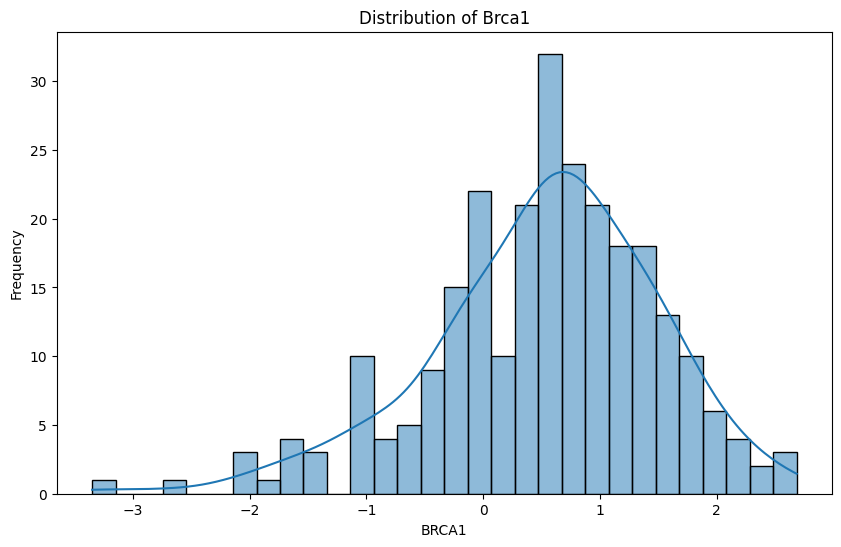

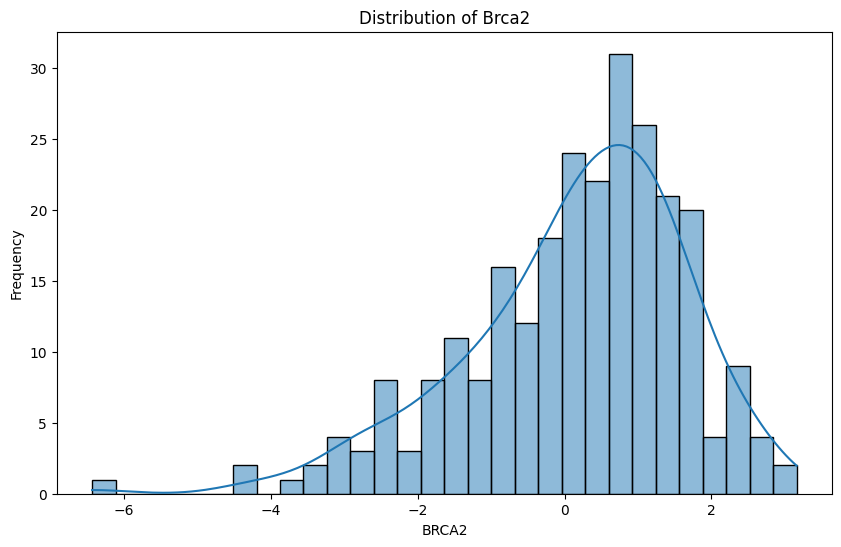

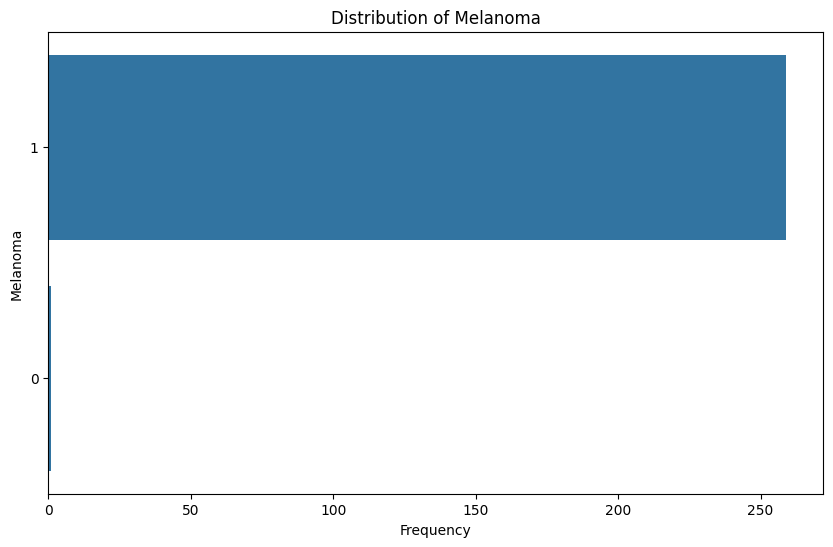

In [9]:
class DataVisualizer:
    def __init__(self, df):
        self.df = df

    def plot_distribution(self, column, numeric=True):
        plt.figure(figsize=(10, 6))
        if numeric:
            sns.histplot(self.df[column], kde=True, bins=30)
            plt.ylabel('Frequency')
        else:
            sns.countplot(y=column, data=self.df, order=self.df[column].value_counts().index)
            plt.xlabel('Frequency')
        plt.title(f'Distribution of {column.capitalize()}')
        plt.show()

    def analyze_distributions(self, numerical_columns, categorical_columns):
        for col in numerical_columns:
            self.plot_distribution(col, numeric=True)

        for col in categorical_columns:
            self.plot_distribution(col, numeric=False)

# Usage
visualizer = DataVisualizer(merged_data)

# For example, choose a few genes you are interested in for visualization:
interested_genes = [col for col in gene_list if 'brca' in col.lower()]
visualizer.analyze_distributions(numerical_columns=[condition_col, *interested_genes], 
                                 categorical_columns=[trait])

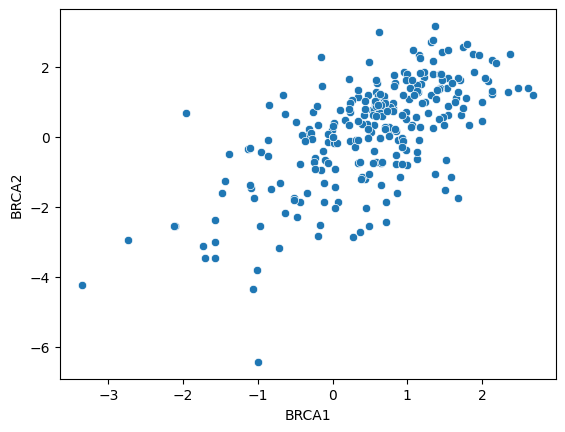

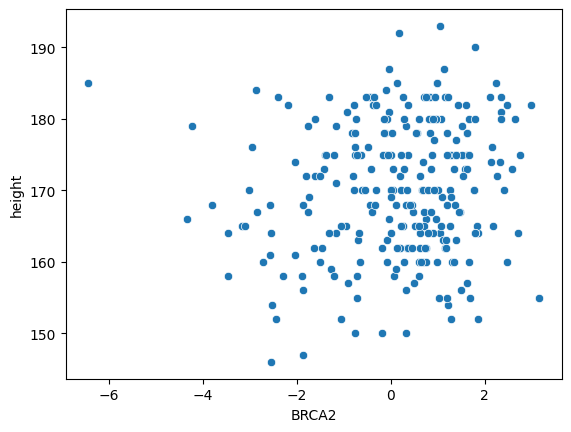

In [10]:
sns.scatterplot(data=merged_data, x='BRCA1', y='BRCA2')
plt.show()

sns.scatterplot(data=merged_data, x='BRCA2', y=condition_col)
plt.show()

### 3. Do regression & Cross Validation

In [11]:

def replace_infinity_with_nan(data):
    """Replace infinity values with NaN."""
    return np.where(np.isinf(data), np.nan, data)

def compute_normalization_params(data):
    """Compute mean and standard deviation, handling zero standard deviation."""
    mean = np.nanmean(data, axis=0)
    std = np.nanstd(data, axis=0)
    std[std <= 1e-8] = 1  # Avoid division by zero
    return mean, std

def normalize_data(data, mean, std):
    """Normalize data using given mean and standard deviation."""
    data_normalized = np.where(np.isnan(data), 0, (data - mean) / std)
    return data_normalized

def preprocess_data(X_train, X_test=None):
    X_train = replace_infinity_with_nan(X_train)
    mean_train, std_train = compute_normalization_params(X_train)

    X_train_normalized = normalize_data(X_train, mean_train, std_train)

    if X_test is not None:
        X_test = replace_infinity_with_nan(X_test)
        X_test[:, std_train <= 1] = 0  # Set zero std columns in test data to zero
        X_test_normalized = normalize_data(X_test, mean_train, std_train)
    else:
        X_test_normalized = None

    return X_train_normalized, X_test_normalized


In [12]:
def split_data(X, y, indices, train_indices, test_indices):
    """Split data into training and testing sets based on indices."""
    X_train, X_test = X[train_indices], X[test_indices]
    y_train, y_test = y[train_indices], y[test_indices]
    return X_train, X_test, y_train, y_test

def train_and_predict(X_train, y_train, X_test):
    """Train the model and make predictions."""
    var_select = VariableSelection()
    var_select.fit(X_train, y_train)
    predictions = var_select.predict(X_test)
    return predictions

def evaluate_accuracy(predictions, y_test):
    """Evaluate the accuracy of predictions."""
    binary_predictions = (predictions > 0.5).astype(int)
    return np.mean(binary_predictions == y_test)

def cross_validation(X, y, k=5):
    indices = np.arange(X.shape[0])
    np.random.shuffle(indices)

    fold_size = len(X) // k
    accuracies = []

    for i in range(k):
        test_indices = indices[i*fold_size : (i+1)*fold_size]
        train_indices = np.setdiff1d(indices, test_indices)

        X_train, X_test, y_train, y_test = split_data(X, y, indices, train_indices, test_indices)
        X_train, X_test = preprocess_data(X_train, X_test)

        predictions = train_and_predict(X_train, y_train, X_test)
        accuracy = evaluate_accuracy(predictions, y_test)
        accuracies.append(accuracy)

    return np.mean(accuracies), np.std(accuracies)

# Select relevant columns and convert to numpy array
y = merged_data[trait].values
X = merged_data.drop(columns=[trait]).values

cv_mean, cv_std = cross_validation(X, y)
print(f'The cross-validation accuracy is {(cv_mean * 100):.2f}% ± {(cv_std * 100):.2f}%')

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sparse_lmm/helpingMethods.py:49: RuntimeWarning: invalid value encountered in divide
  ts = beta / np.sqrt(var * sigma)


The cross-validation accuracy is 40.38% ± 25.25%


In [13]:

def prepare_data(merged_data, trait):
    """Prepare and preprocess the dataset."""
    y = merged_data[trait].values
    X = merged_data.drop(columns=[trait]).values
    X, _ = preprocess_data(X)  # Assuming preprocess_data is defined elsewhere
    return X, y

def fit_model(X, y):
    """Fit the VariableSelection model to the data."""
    var_select = VariableSelection()
    var_select.fit(X, y)
    return var_select

def get_model_output(var_select):
    """Retrieve and process the model's output."""
    coefficients = var_select.getBeta().reshape(-1).tolist()
    nlog_p_values = var_select.getNegLogP().reshape(-1).tolist()
    p_values = [np.exp(-p) for p in nlog_p_values]
    return coefficients, p_values

# Main execution
X, y = prepare_data(merged_data, trait)
var_select = fit_model(X, y)
coefficients, p_values = get_model_output(var_select)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sparse_lmm/helpingMethods.py:49: RuntimeWarning: invalid value encountered in divide
  ts = beta / np.sqrt(var * sigma)


### 4. Discussion

In [14]:
import pandas as pd
from statsmodels.stats.multitest import multipletests


# Create a DataFrame for the regression results
regression_df = pd.DataFrame({
    'Variable': feature_cols,
    'Coefficient': coefficients,
    'p_value': p_values
})

# Extract information about the lifestyle condition's effect
condition_effect = regression_df.iloc[0]

# Report the effect of the lifestyle condition
print(f"Effect of the condition on the target variable:")
print(f"Variable: {condition}")
print(f"Coefficient: {condition_effect['Coefficient']:.4f}")
print(f"p-value: {condition_effect['p_value']:.4g}\n")

Effect of the condition on the target variable:
Variable: height
Coefficient: -0.0048
p-value: 0.4319



In [15]:
threshold = 0.05
# Apply the Benjamini-Hochberg correction
rejected, corrected_p_values, _, _ = multipletests(regression_df['p_value'][1:], alpha=threshold, method='fdr_bh')

# Add the corrected p-values to the DataFrame (ignoring the first row which is the condition)
regression_df.loc[1:, 'corrected_p_value'] = corrected_p_values

# Now filter based on the corrected p-values
significant_genes = regression_df.loc[(regression_df.index > 0) & (regression_df['corrected_p_value'] < threshold)]
significant_genes_sorted = significant_genes.sort_values('corrected_p_value')

# Print and/or save your results as before
print(f"Genes with corrected p-value < {threshold}, affecting the trait {trait} conditional on the factor {condition}, sorted by corrected p-value:")
print(significant_genes_sorted[['Variable', 'Coefficient', 'corrected_p_value']].to_string(index=False))
print(f"\nFound {len(significant_genes_sorted)} significant genes with corrected p-value < {threshold}")
# Save this to a CSV file
significant_genes_sorted.to_csv('significant_genes_report_corrected.csv', index=False)

Genes with corrected p-value < 0.05, affecting the trait Melanoma conditional on the factor height, sorted by corrected p-value:
    Variable  Coefficient  corrected_p_value
      RBMY1B    -0.071687       4.565339e-67
      RBMY1J    -0.071352       1.136279e-47
      TTTY23    -0.056340       3.498903e-33
       DEFA4    -0.063412       3.498903e-33
      OR13C3    -0.053397       4.733014e-32
   C14orf165    -0.051975       1.123816e-19
      OR5D14     0.034318       2.117124e-13
      TEX101    -0.063501       3.603011e-13
     C7orf66    -0.045558       7.110278e-13
DKFZP434H168    -0.041279       1.291295e-10
       OR8G2    -0.044121       1.490210e-10
        CHIA    -0.056708       2.026620e-09
       OR8B2    -0.038465       2.605236e-07
       RGPD5     0.051964       2.942041e-07
       CELA1    -0.044680       5.914341e-07
     SNORA75    -0.036968       5.914341e-07
      PLSCR2    -0.039014       1.016484e-06
       P2RX2    -0.051650       6.810920e-06
      MMP23A    